# Rescaling example notebook

## Table of contents:

- [Pixel isotrophy as a  precondition for many algorithms](#pixel-isotrophy-as-a-precondition-for-many-algorithms)
    - [Changing displaying of the image](#changing-displaying-of-the-image)
- [Scaling factors and how to compute them](#scaling-factors-and-how-to-compute-them)
    - [Downscaling](#downscaling)
        - [Using clesperanto scale function](#using-clesperanto-scale-function)
        - [Using skimage rescale](#using-skimage-rescale)
    - [Upscaling](#upscaling)
        - [Using clesperanto scale function](#using-clesperanto-scale-function)
        - [Using skimage rescale](#using-skimage-rescale)
- [Demonstration of how anisotropic pixels can manipulate measurements](#demonstration-of-how-anisotropic-pixels-can-manipulate-measurements)
- [Additional: Working with czi-files](#additional:-working-with-czi-files)
    - [Displaying the pixel size using napari-layer-details-display](#displaying-the-pixel-size-using-napari-layer-details-display)

## Pixel isotrophy as a  precondition for many algorithms 

__Dataset:__

[Ozpolat, B. et al](https://doi.org/10.5281/zenodo.1063531) licensed [CC BY 4.0](https://creativecommons.org/licenses/by/4.0/legalcode)

For demonstration purposes, _one timepoint_ (timepoint 7) of this timelapse dataset was selected.

How to handle the _whole timelapse czi-file_ is demonstrated [below](##additional:-working-with-czi-files).

In [1]:
import napari
from skimage.io import imread
import pyclesperanto_prototype as cle
from skimage import filters
from skimage.transform import rescale
import time
from napari_segment_blobs_and_things_with_membranes import voronoi_otsu_labeling

In [2]:
img = imread("imgs/tp7_channel1.tif")

In [3]:
#getting the image shape in order (channel,z,y,x)
print('pixels (z, y, x) = ', img.shape)

pixels (z, y, x) =  (44, 1024, 1024)


In [4]:
viewer = napari.Viewer()

The pixel/voxel size can be derived from the metadata of the czi-file demonstrated [below](#displaying-the-pixel-size-using-napari-layer-details-display) and we get the following information:

In [5]:
voxelsize_x = 0.1596665040315075
voxelsize_y = 0.1596665040315075
voxelsize_z = 1.5

We can see that the pixels are anisotropic (= different size in z than in x & y). This can also be seen when opening the image in napari:

In [6]:
#add image to napari
layer = viewer.add_image(img, colormap = 'cyan', blending = 'additive')

If you open the image in napari, you can see that it"s nicely displayed in the x-y-plane:

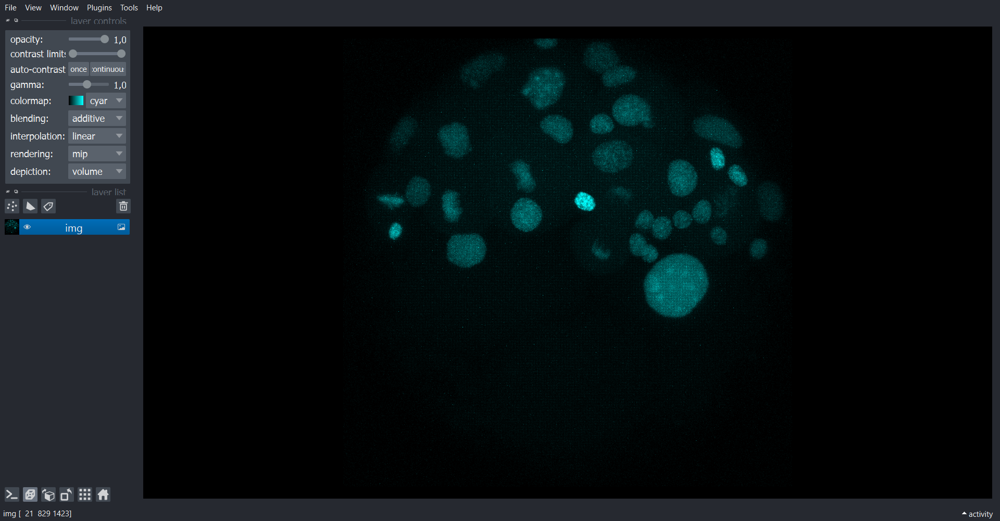

In [33]:
napari.utils.nbscreenshot(viewer)

but in the y-z-plane it looks squeezed:

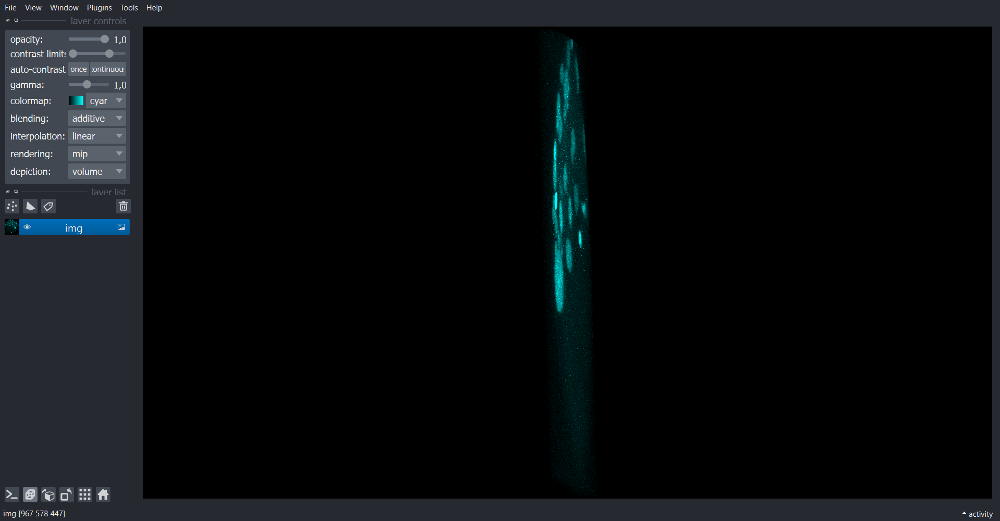

In [23]:
napari.utils.nbscreenshot(viewer)

### Changing displaying of the image 

We can change the displaying in napari by giving factors. Here I used the voxelsize, but you can also choose different scaling factors:

In [25]:
#display scaling in napari
viewer.layers['img'].scale=[voxelsize_z, voxelsize_y, voxelsize_x]

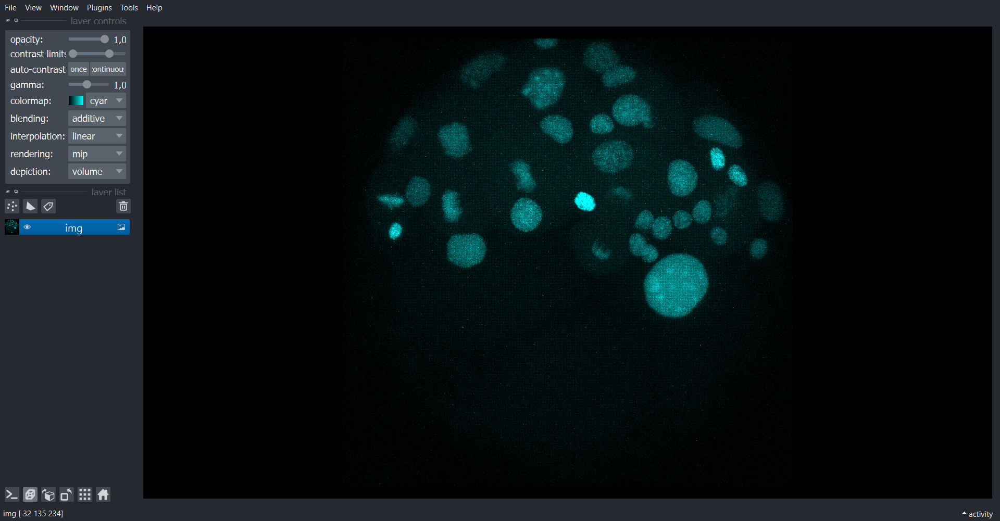

In [26]:
napari.utils.nbscreenshot(viewer)

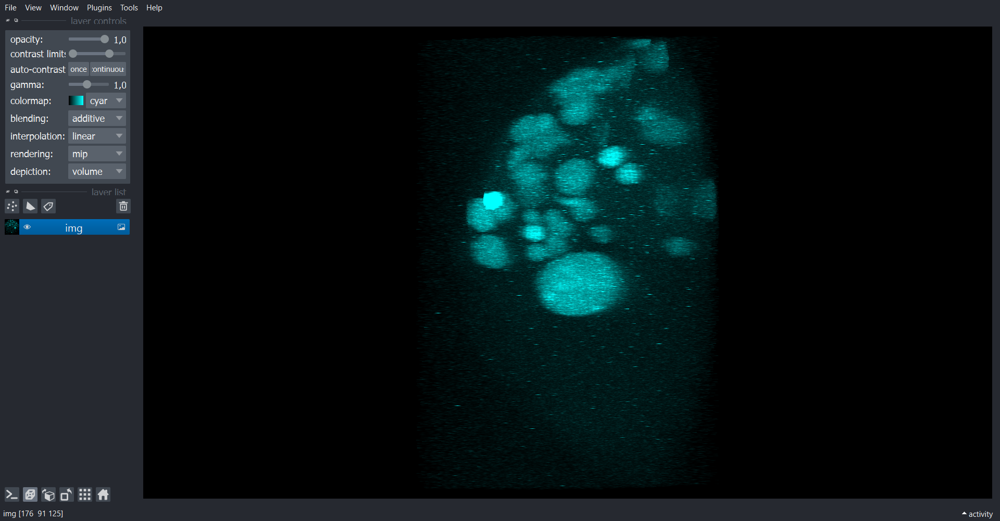

In [27]:
napari.utils.nbscreenshot(viewer)

Note: Here only the displaying is changed, but the image has still the same shape.

In [28]:
#print image shape
image_from_layer = viewer.layers['img'].data
print('pixels (z, y, x) = ', image_from_layer.shape)

pixels (z, y, x) =  (44, 1024, 1024)


The pixels are still anisotropic! In fact, if you open a proprietary image file using a napari-plugin, like [napari-aicsimageio](https://github.com/AllenCellModeling/napari-aicsimageio), these scaling factors are often already automatically applied.

## Scaling factors and how to compute them

Here, two ways are shown for rescaling: The  [`clesperanto scale`](https://github.com/clEsperanto/pyclesperanto_prototype) function and the [`skimage rescale`](https://scikit-image.org/docs/stable/auto_examples/transform/plot_rescale.html) function.

### Scaling using the image voxel size

When we rescale using the image voxel size we are doing both down- and upscaling at the same time: downscaling in x and y (voxelsize < 1), while upscaling in z (voxelsize > 1)

#### Using clesperanto scale function

In [17]:
#rescale
img_rescaled_cle = cle.scale(img, factor_x = voxelsize_x, factor_y = voxelsize_y, factor_z = voxelsize_z, auto_size = True)

The image is now rescaled to this size:

In [18]:
#print image shape
print('pixels (z, y, x) = ', img_rescaled_cle.shape)

pixels (z, y, x) =  (66, 163, 163)


In [19]:
#add downscaled channels to viewer
viewer.add_image(img_rescaled_cle, name = 'img_rescaled')

<Image layer 'img_rescaled' at 0x1f7239d3ee0>

You can see the rescaled image in the top left corner:

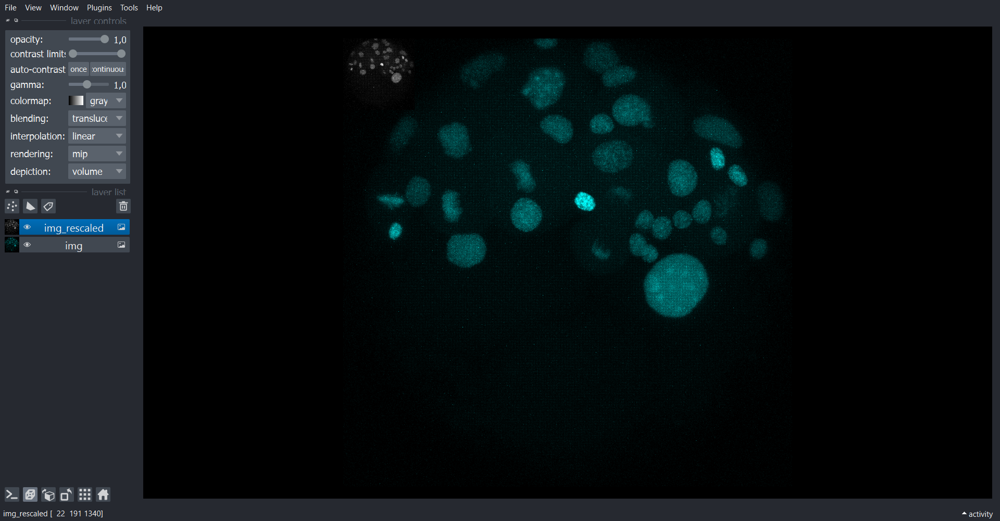

In [44]:
napari.utils.nbscreenshot(viewer)

When we have a look only at the rescaled image, we can see that pixels were removed: When we have a look only at the rescaled image, we can see that information was reduced:

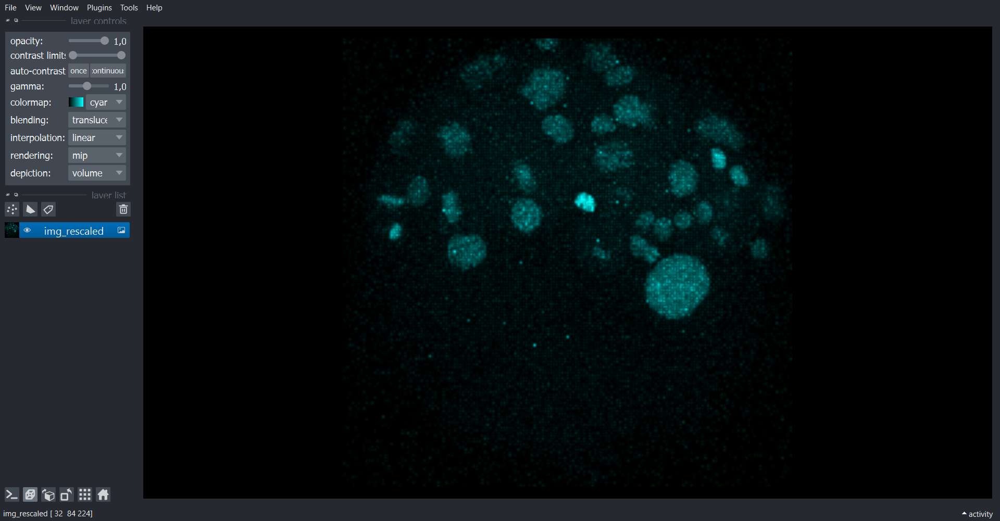

In [47]:
napari.utils.nbscreenshot(viewer)

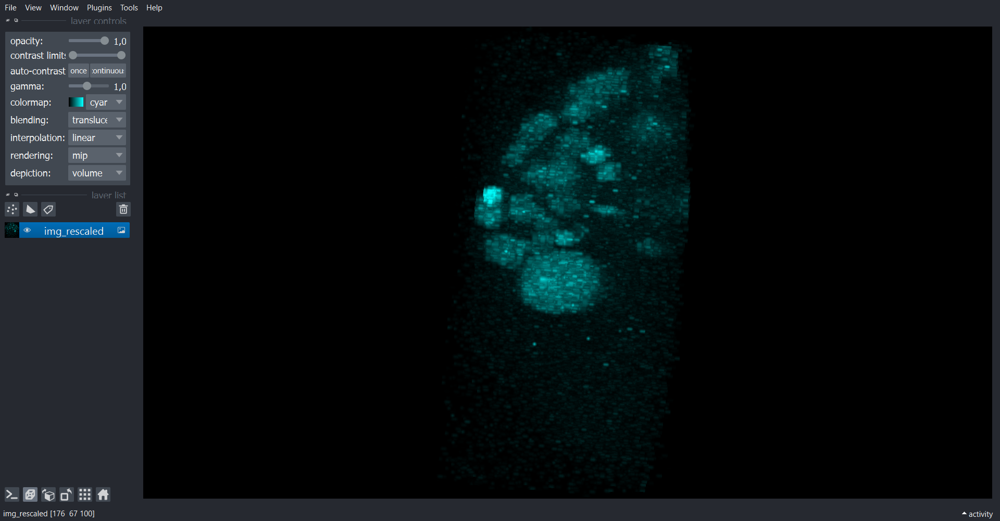

In [48]:
napari.utils.nbscreenshot(viewer)

If we rescale using voxelsize/2, /4 and /8 the loss of information becomes even more obvious:

In [109]:
#rescale with factors
img_rescaled_2 = cle.scale(img, factor_x = (voxelsize_x/2), factor_y = (voxelsize_y/2), factor_z = (voxelsize_z/2), auto_size = True)
img_rescaled_4 = cle.scale(img, factor_x = (voxelsize_x/4), factor_y = (voxelsize_y/4), factor_z = (voxelsize_z/4), auto_size = True)
img_rescaled_8 = cle.scale(img, factor_x = voxelsize_x/8, factor_y = voxelsize_y/8, factor_z = voxelsize_z/8, auto_size = True)

In [116]:
viewer.add_image(img_rescaled_2, name = 'img_rescaled_2')

<Image layer 'img_rescaled_2' at 0x231b229a670>

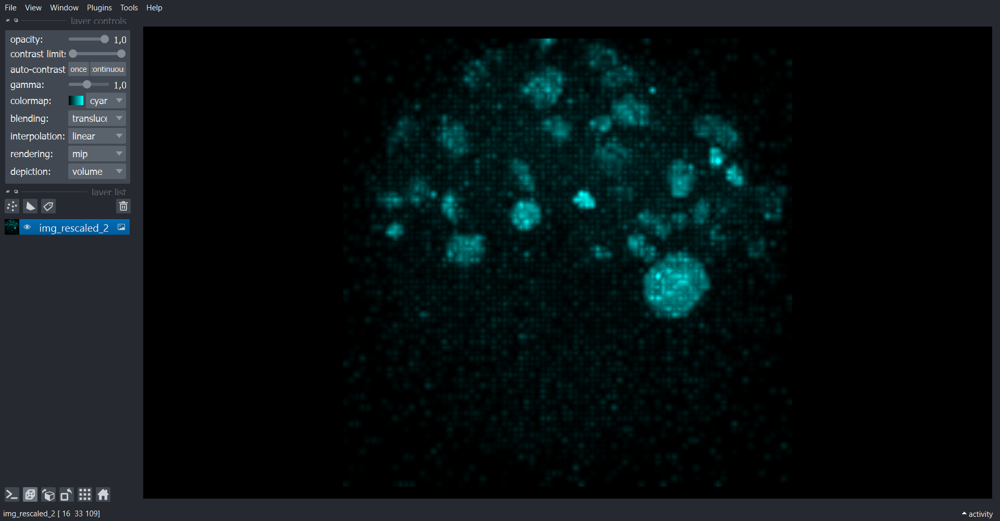

In [117]:
napari.utils.nbscreenshot(viewer)

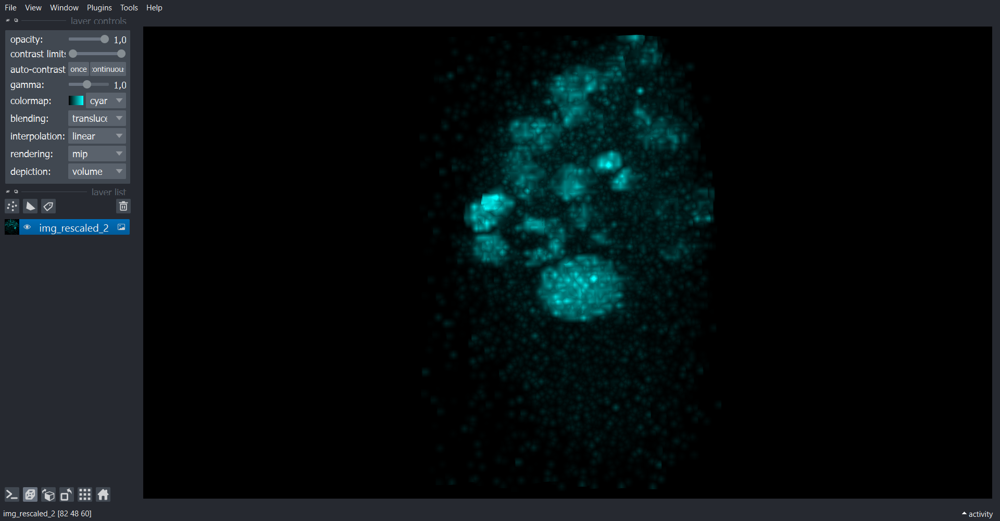

In [118]:
napari.utils.nbscreenshot(viewer)

In [119]:
viewer.add_image(img_rescaled_4, name = 'img_rescaled_4')

<Image layer 'img_rescaled_4' at 0x231b278ab50>

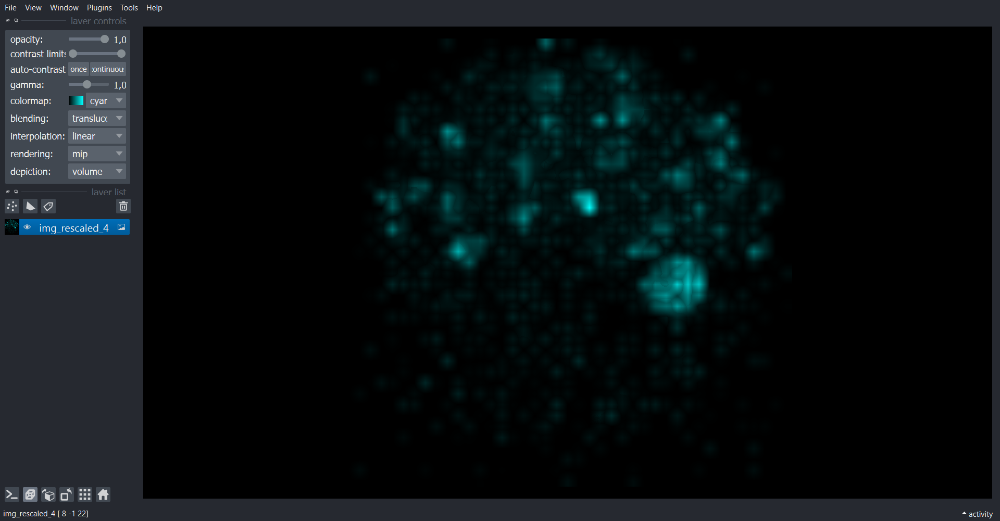

In [120]:
napari.utils.nbscreenshot(viewer)

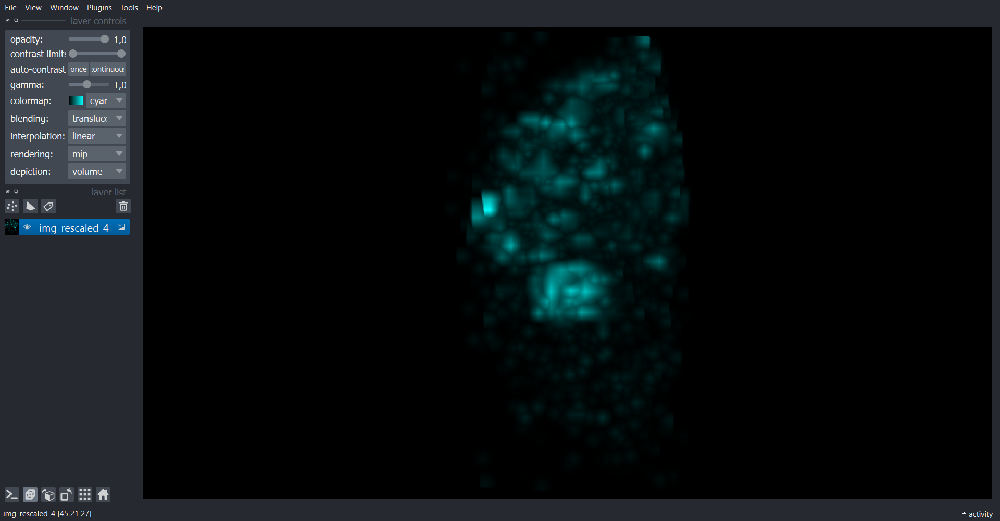

In [121]:
napari.utils.nbscreenshot(viewer)

In [122]:
viewer.add_image(img_rescaled_8, name = 'img_rescaled_8')

<Image layer 'img_rescaled_8' at 0x231b288c790>

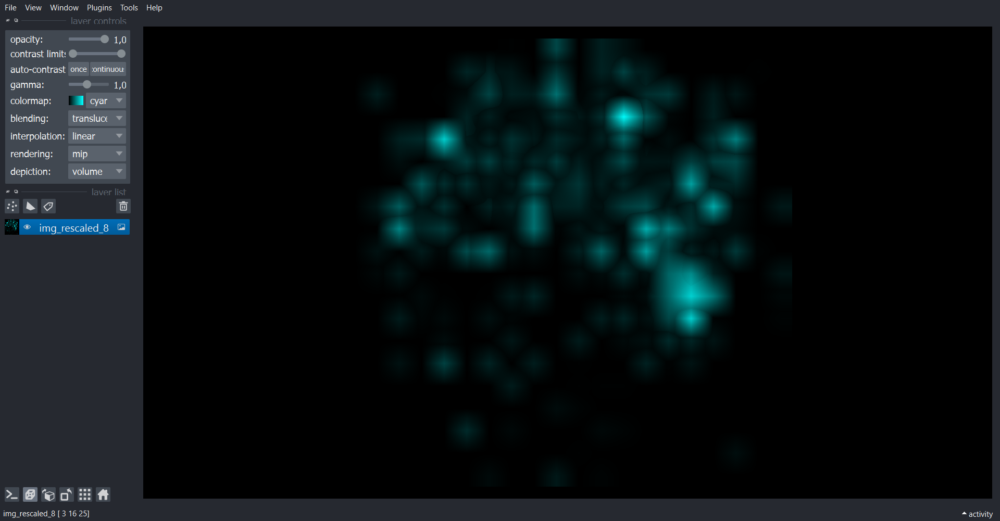

In [125]:
napari.utils.nbscreenshot(viewer)

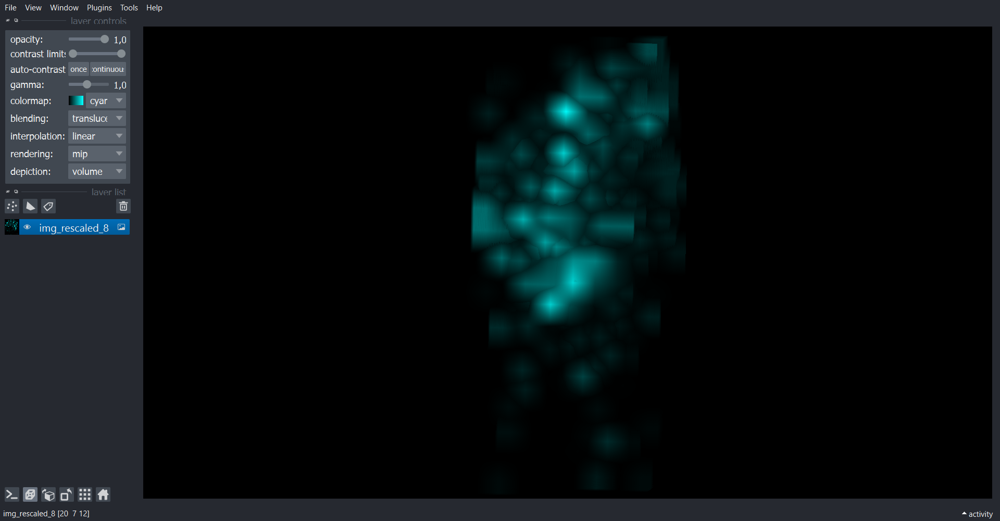

In [124]:
napari.utils.nbscreenshot(viewer)

#### Using skimage rescale

In [9]:
#downscaling each channel
img_rescaled_skimage = rescale(img, [voxelsize_z, voxelsize_y, voxelsize_x])           

In [129]:
#adding channels to viewer
viewer.add_image(img_rescaled_skimage, name = 'img_rescaled_skimage')

<Image layer 'img_rescaled_skimage' at 0x231b3b64070>

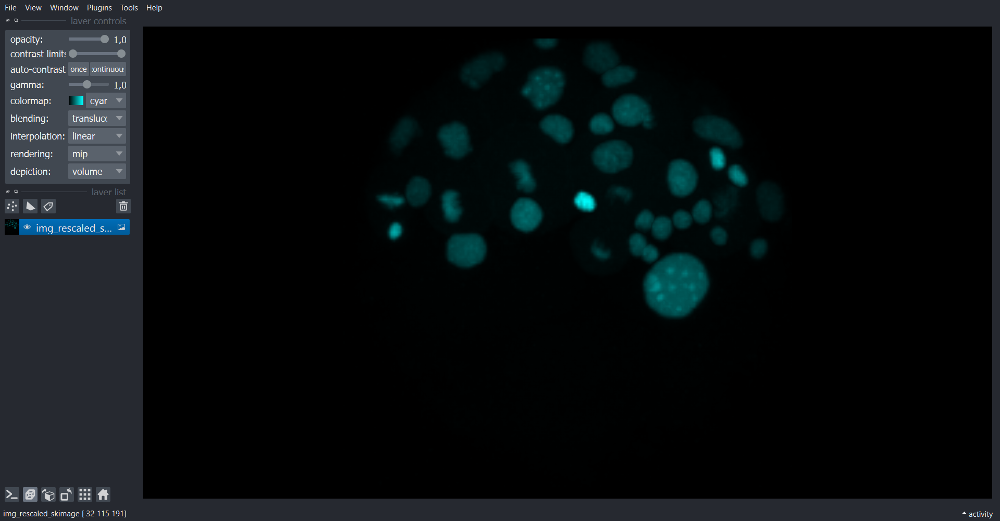

In [130]:
napari.utils.nbscreenshot(viewer)

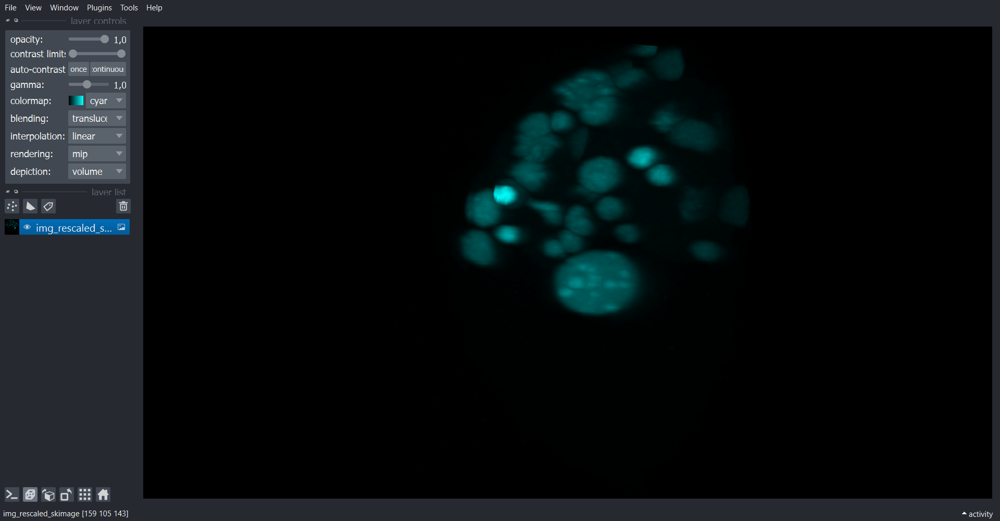

In [131]:
napari.utils.nbscreenshot(viewer)

### Upscaling

We now upscale using the voxelsize of x & y as reference:

In [7]:
upscaled_z = voxelsize_z/voxelsize_x

In [8]:
upscaled_z

9.394581594296072

#### Using clesperanto scale function

In [9]:
#upscaling each channel
img_upscaled_cle = cle.scale(img, factor_x = 1, factor_y = 1, factor_z = upscaled_z, auto_size = True)

In [10]:
#print image shape
print('pixels (z, y, x) = ', img_upscaled_cle.shape)

pixels (z, y, x) =  (413, 1024, 1024)


In [11]:
#add channels to viewer
viewer.add_image(img_upscaled_cle, name = 'img_upscaled')

<Image layer 'img_upscaled' at 0x2a5a5a045e0>

AICSImageIO: Reader will load image in-memory: False


When we have a look only at the upscaled image, we can see that pixels were added:

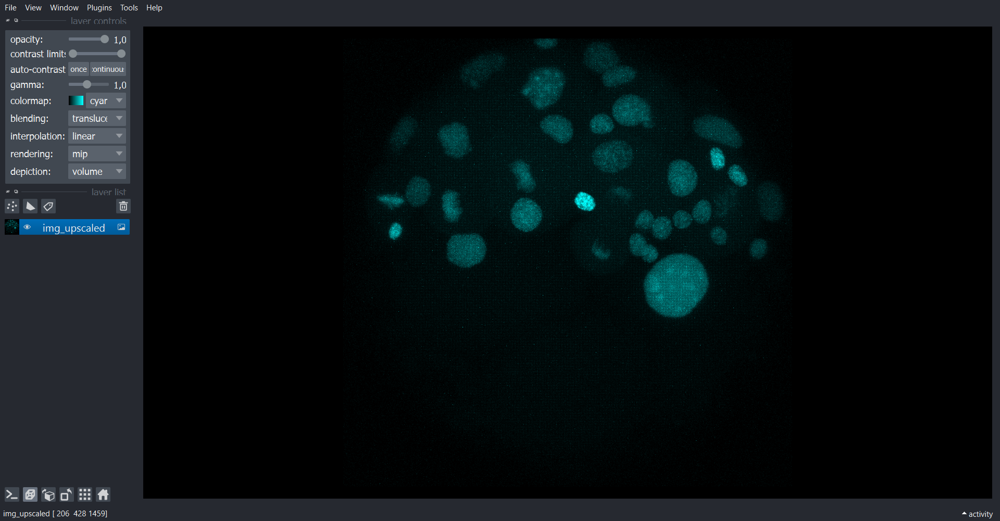

In [138]:
napari.utils.nbscreenshot(viewer)

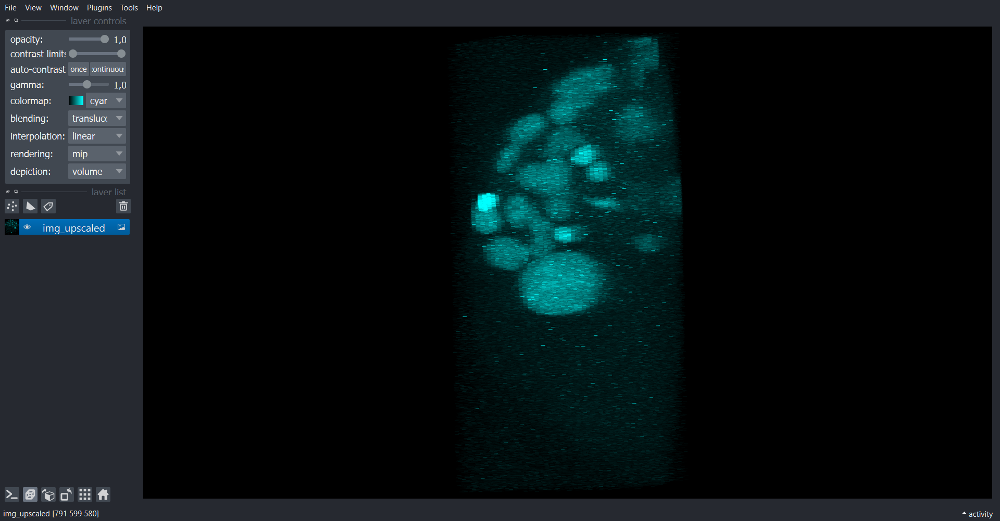

In [139]:
napari.utils.nbscreenshot(viewer)

#### Using skimage rescale

In [9]:
img_upscaled_skimage = rescale(img, [upscaled_z, 1, 1])

In [143]:
viewer.add_image(img_upscaled_skimage, name = 'img_upscaled_skimage')

<Image layer 'img_upscaled_skimage' at 0x231b3c5d100>

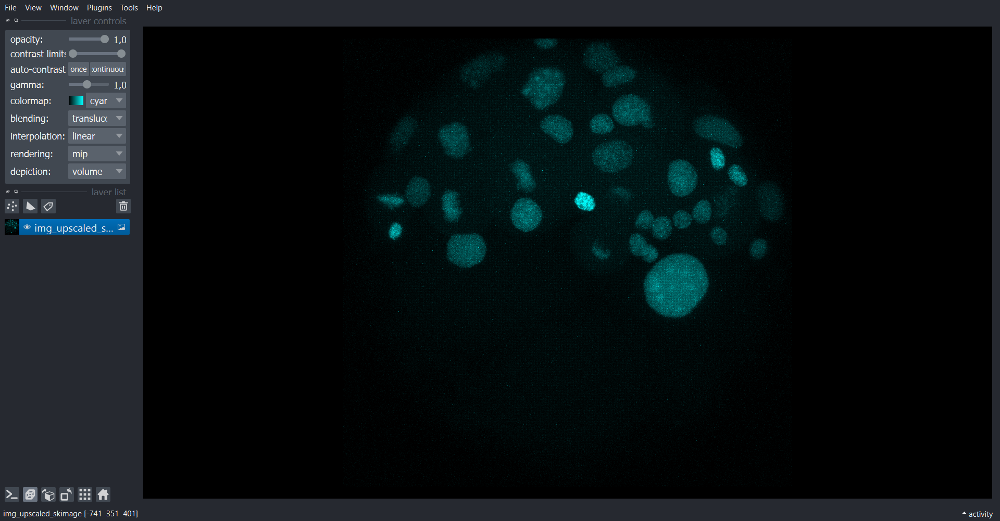

In [144]:
napari.utils.nbscreenshot(viewer)

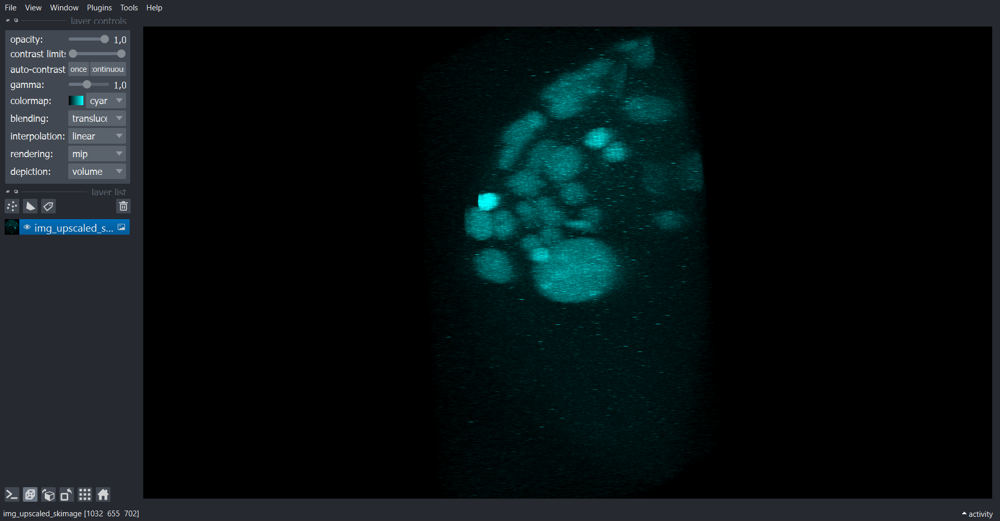

In [145]:
napari.utils.nbscreenshot(viewer)

## Demonstration of how anisotropic pixels can manipulate measurements

The scaling makes a difference on the performance of different algorithms. For example filters like the gaussian blur or the rolling ball algorithm, but also segmentation algorithms like voronoi-otsu-labelling or quantitative measurement methods.
Let's compare the time it takes and output when we apply [voronoi-otsu-labeling](https://haesleinhuepf.github.io/BioImageAnalysisNotebooks/20_image_segmentation/11_voronoi_otsu_labeling.html):

In [10]:
sigma_spot_detection = 10
sigma_outline = 5

### Original (anisotropic)

In [11]:
#starttime
start_anisotropic = time.time()

#apply filter
label_img = voronoi_otsu_labeling(img, spot_sigma=sigma_spot_detection, outline_sigma=sigma_outline)

#endtime
end_anisotropic = time.time()

#ad to viewer
viewer.add_image(label_img, name = 'label_img')

#return time 
time_anisotropic = end_anisotropic - start_anisotropic
print("The anisotropic image took for voronoi-otsu-labeling =", time_anisotropic, "seconds")

NameError: name 'viewer' is not defined

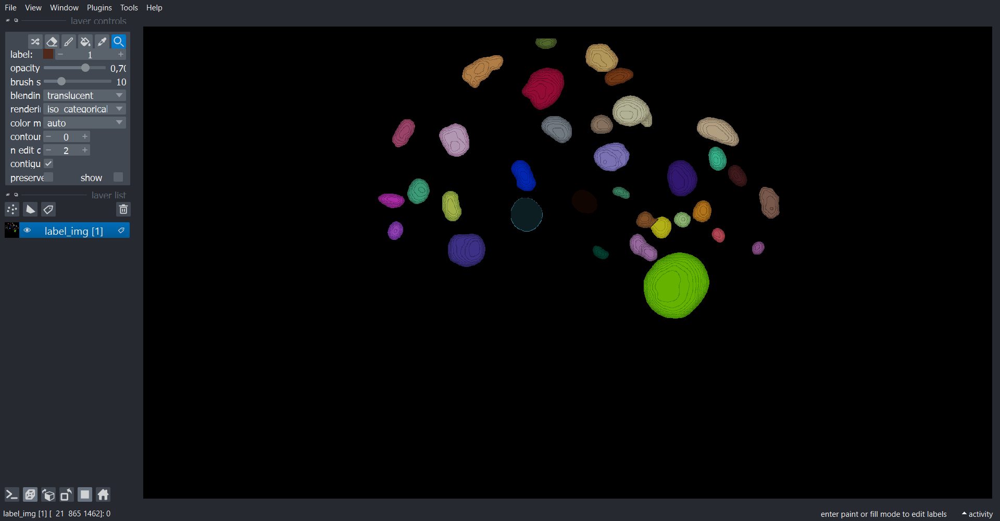

In [19]:
napari.utils.nbscreenshot(viewer)

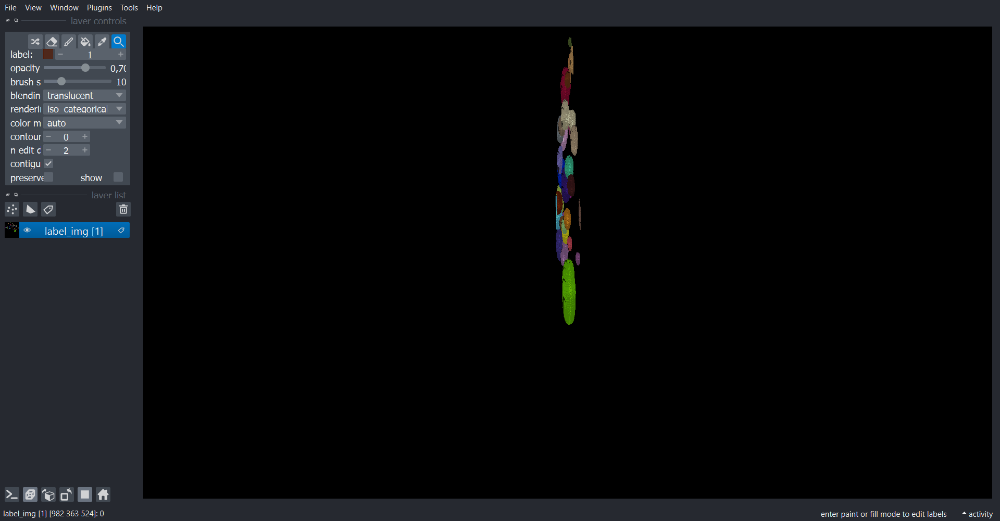

In [20]:
napari.utils.nbscreenshot(viewer)

### Rescaled using voxel size

In [21]:
#starttime
start_rescaled = time.time()

#apply filter
label_img_rescaled_skimage = voronoi_otsu_labeling(img_rescaled_skimage, spot_sigma=sigma_spot_detection, outline_sigma=sigma_outline)

#endtime
end_rescaled = time.time()

#add to viewer
viewer.add_image(label_img_rescaled_skimage, name = 'label img rescaled skimage')

#return time
time_rescaled = end_rescaled - start_rescaled
print("The rescaled image took for voronoi-otsu-labeling =", time_rescaled, "seconds")

The rescaled image took for voronoi-otsu-labeling = 0.390592098236084 seconds


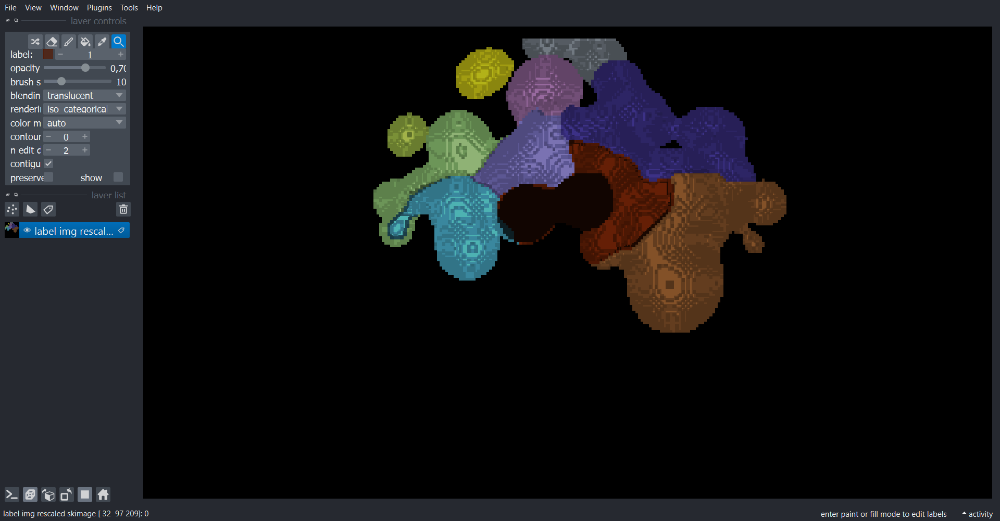

In [22]:
napari.utils.nbscreenshot(viewer)

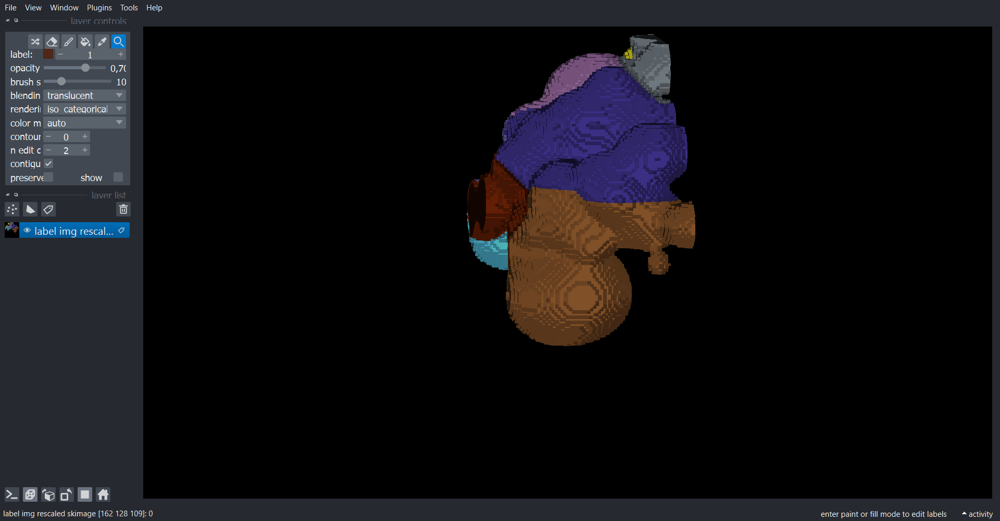

In [23]:
napari.utils.nbscreenshot(viewer)

### Upscaled

In [ ]:
#starttime
start_upscaled = time.time()

#apply filter
label_img_upscaled_skimage = voronoi_otsu_labeling(img_upscaled_skimage, spot_sigma=sigma_spot_detection, outline_sigma=sigma_outline)

#endtime
end_upscaled = time.time()

#add to viewer
viewer.add_image(label_img_upscaled_skimage, name = 'label img upscaled skimage')

#return time
time_upscaled = end_upscaled - start_upscaled
print("The upscaled image took for voronoi-otsu-labeling =", time_upscaled, "seconds")

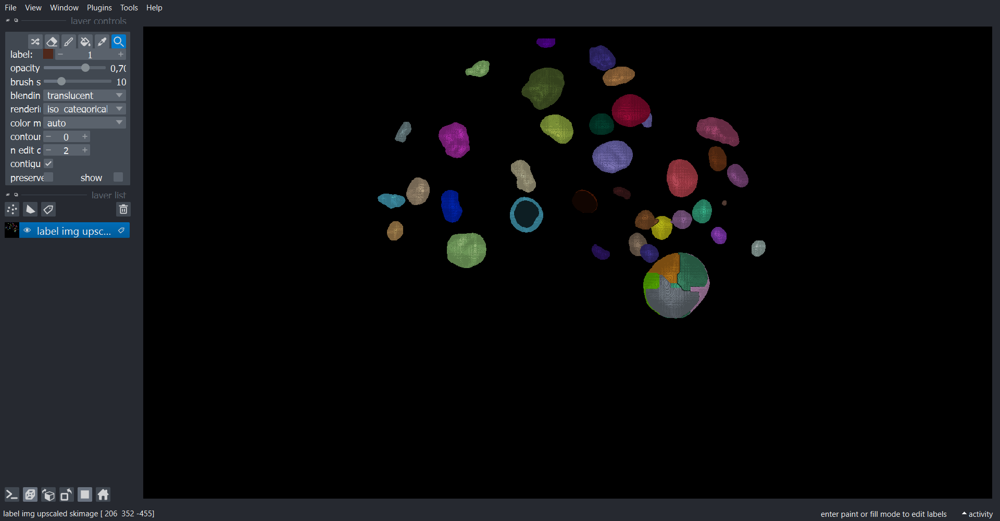

In [25]:
napari.utils.nbscreenshot(viewer)

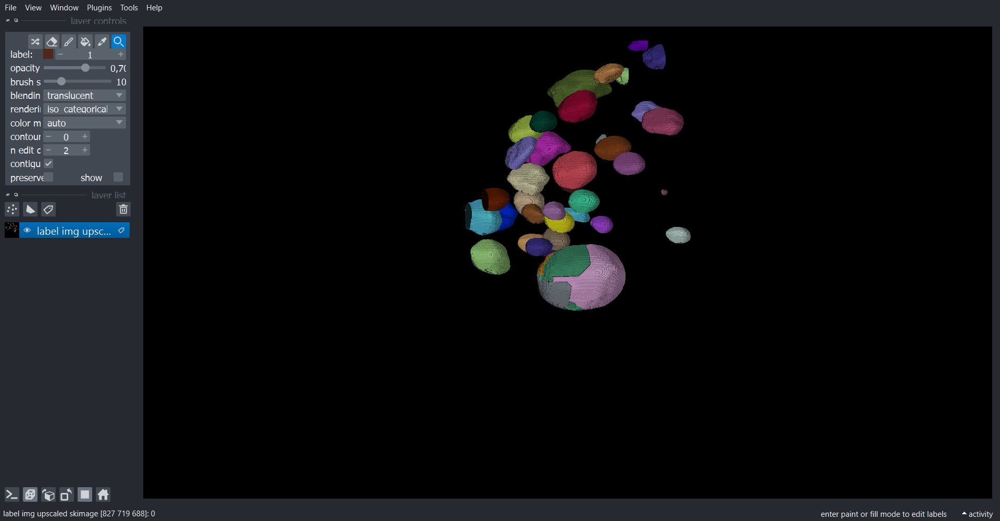

In [26]:
napari.utils.nbscreenshot(viewer)

We can see that time to apply voronoi-otsu-labeling is rescaled using voxel size < original < upscaled.

Through the addition of more pixels during upscaling we could run into memory issues when proceeding with a workflow.

## Additional: Working with czi-files

In [76]:
from skimage.io import imread
import napari
from aicsimageio import AICSImage
from aicsimageio.readers import BioformatsReader

### First way to open the czi-file

In [77]:
viewer = napari.Viewer()

In [78]:
#opening the image using aicsimageio
viewer.open(path = 'C:/Users/maral/Documents/WHK Bio-image Analysis Group/1. Nuclei und Zellen segmentieren, tracken, klassifizieren/Image 6_Subset-pos02_t1-35.czi', 
            plugin = 'aicsimageio-out-of-memory')

AICSImageIO: Reader will load image in-memory: False


[<Image layer '0 :: Image 6_Subset-pos02_t1-35 #1 :: ChS1' at 0x231ac969ee0>,
 <Image layer '0 :: Image 6_Subset-pos02_t1-35 #1 :: Ch2' at 0x23199616d30>,
 <Image layer '0 :: Image 6_Subset-pos02_t1-35 #1 :: T PMT' at 0x231d5a564c0>]

If we open the czi-file using aicsimageio, the displaying of the image is already adjusted using the voxelsize as scaling factors.

In [ ]:
viewer.layers[0].scale

array([1.       , 1.5      , 0.1596665, 0.1596665])

## Displaying the pixel size using napari-layer-details-display

We can also see this in napari using the _Layer Details Display_ plugin:

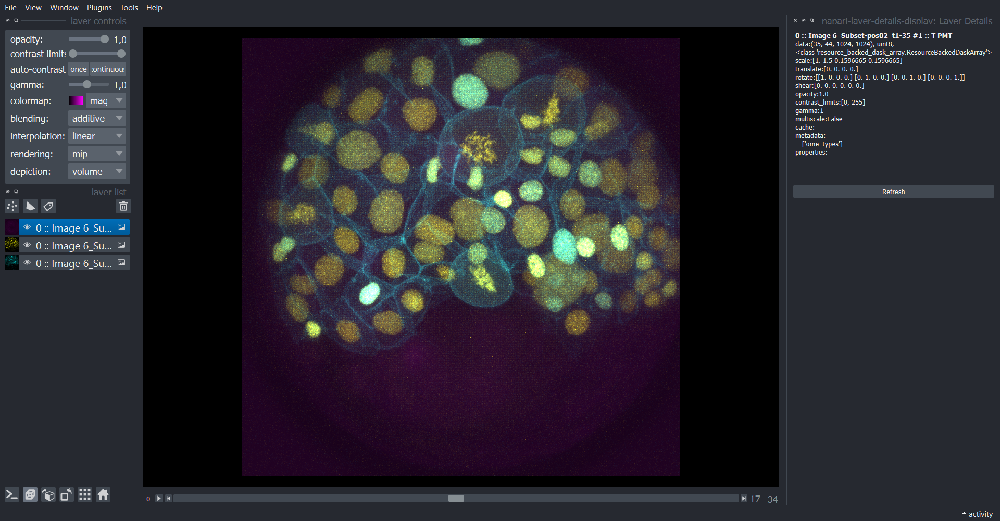

In [4]:
napari.utils.nbscreenshot(viewer)

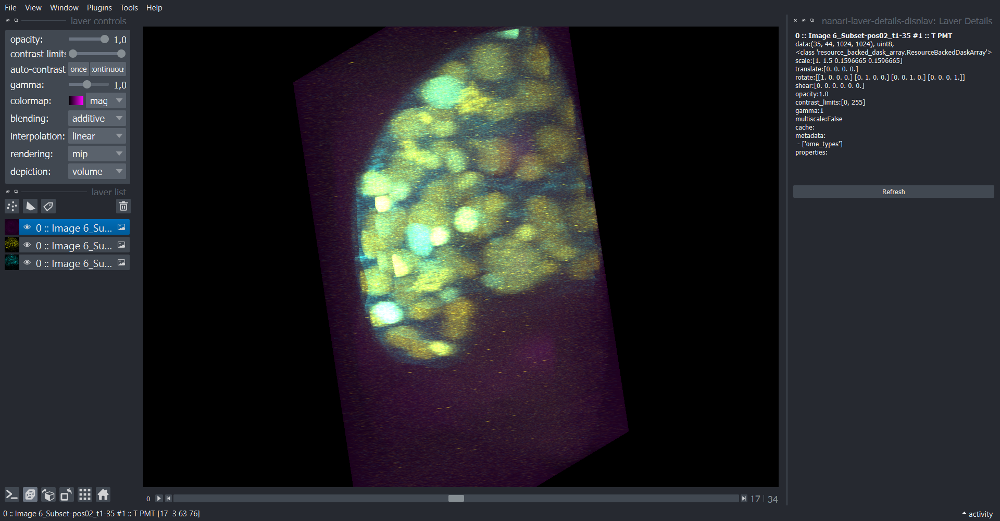

In [5]:
napari.utils.nbscreenshot(viewer)

In [24]:
#print image shape
image_from_layer = viewer.layers[0].data
print('pixels (timepoints, z, y, x) = ', image_from_layer.shape)

pixels (timepoints, z, y, x) =  (35, 44, 1024, 1024)


We can see that the image size has not changed. So the pixels are still anisotropic.

### Second way to open the czi-file

There is also second way to load the data:

In [5]:
#load image
img = AICSImage('C:/Users/maral/Documents/WHK Bio-image Analysis Group/1. Nuclei und Zellen segmentieren, tracken, klassifizieren/Image 6_Subset-pos02_t1-35.czi', reader=BioformatsReader)

In [5]:
original = img.data

In [10]:
channel0 = original[:,0]
channel1 = original[:,1]
channel2 = original[:,2]

In [6]:
viewer = napari.Viewer()

In [ ]:
layer0 = viewer.add_image(channel0, metadata = metadata, colormap = 'green', blending = 'additive')
layer1 = viewer.add_image(channel1, metadata = metadata, colormap = 'cyan', blending = 'additive')
layer2 = viewer.add_image(channel2, metadata = metadata, colormap = 'magenta', blending = 'additive')

We can see that the visualisation is squeezed:

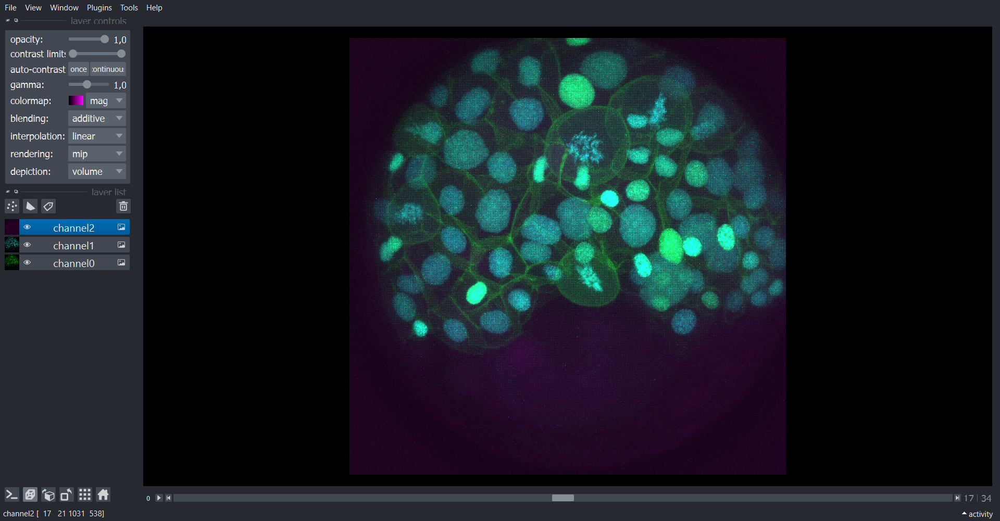

In [12]:
napari.utils.nbscreenshot(viewer)

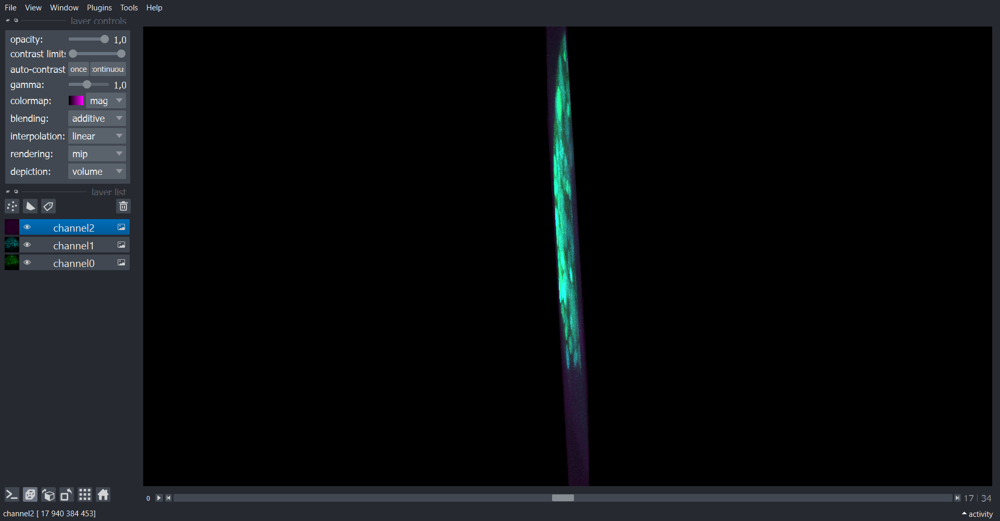

In [13]:
napari.utils.nbscreenshot(viewer)

Because the displaying is not changed:

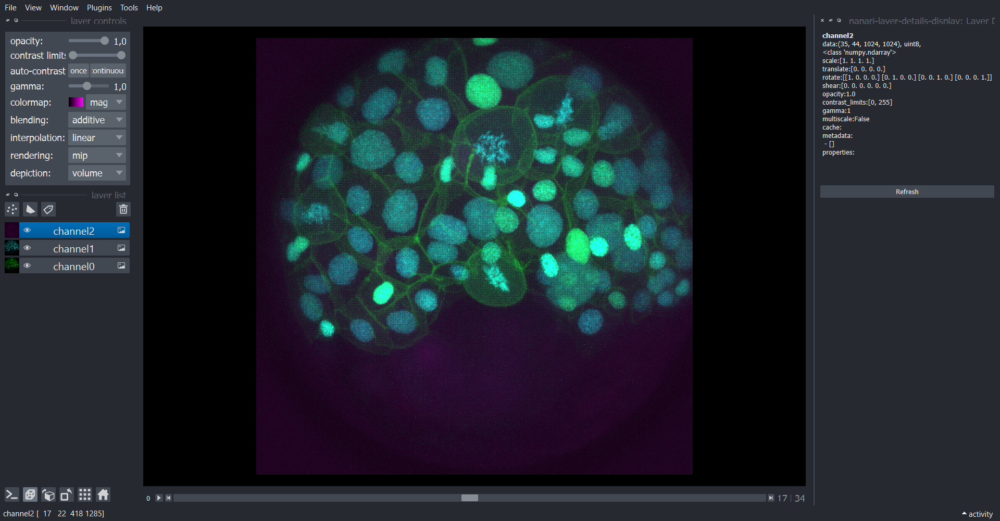

In [7]:
napari.utils.nbscreenshot(viewer)

But we can get the information about the voxel size like this:

In [7]:
metadata = {
    'Pixel Size X' : img.physical_pixel_sizes.X,
    'Pixel Size Y' : img.physical_pixel_sizes.Y,
    'Pixel Size Z' : img.physical_pixel_sizes.Z
}

In [8]:
metadata

{'Pixel Size X': 0.1596665040315075,
 'Pixel Size Y': 0.1596665040315075,
 'Pixel Size Z': 1.5}